In [1]:
using Plots
using Graphs
using Random
using GraphPlot
using StatsBase
using DifferentialEquations
using Base.Threads

# Lucas Schmidt Ferreira de Araujo

In [ ]:
function watts_strogatz_2d(N::Int, k::Int, β::Float64)
    L = Int(sqrt(N))  
    G = SimpleGraph(N)
    function node_index(i, j)
        return ((i - 1) % L) * L + ((j - 1) % L) + 1
    end
    for i in 1:L
        for j in 1:L
            v = node_index(i, j)
            neighbors = [
                node_index(i + di, j + dj)
                for (di, dj) in [(-1,0), (1,0), (0,-1), (0,1)]  
            ]
            for u in neighbors
                add_edge!(G, v, u)
            end
        end
    end
    additional_k = (k - 4) ÷ 2
    for i in 1:L
        for j in 1:L
            v = node_index(i, j)
            for d in 1:additional_k
                add_edge!(G, v, node_index(i, j + d))  
                add_edge!(G, v, node_index(i + d, j))  
            end
        end
    end
    for edge in edges(G)
        if rand() < β
            u, v = src(edge), dst(edge)
            rem_edge!(G, u, v)
            new_v = rand(setdiff(1:N, neighbors(G, u)))  
            add_edge!(G, u, new_v)
        end
    end
    return G
end

watts_strogatz_2d (generic function with 1 method)

In [3]:
function BassDiffusion(nit::Int , states0::Vector{Int} , N::Int , k::Int , β::Float64 , p::Float64 , q ::Float64)
    G = watts_strogatz_2d( N, k, β)
    states = zeros( nit , N )
    states[1,:] = states0
    for t = 1:nit-1
        states[t+1 , : ] = states[t , :]
        for j = 1:N
            n = sample( 1:N )
            state = states[t,n]
            nb = neighbors( G , n )
            if( state == 0 && length(nb) != 0)
                states_ = states[ t , nb ]
                F = sum(states_) / length( nb )
                pf = p + q*F
                states[t+1 , n] =  sample( [0,1] , Weights([1-pf,pf]) )
            end
        end
    end
    return states
end

function Adoption_State(nit::Int , states0::Vector{Int} , N::Int , k::Int , β::Float64 , p::Float64 , q ::Float64 , nsim::Int = 500)
    simulations = [ sum(BassDiffusion( nit , states0 , N , k , β , p , q),dims = 2)[:] for sim in 1:nsim ]
    return mean( simulations , dims = 1)[1]
end

function Time_Stabilization( nit::Int , states0::Vector{Int} , N::Int , k::Int , β::Float64 , p::Float64 , q ::Float64 , nsim::Int = 500 )
    time = Threads.Atomic{Float64}(0.0)
    @Threads.threads for sim = 1:nsim
        simulation = sum(BassDiffusion( nit , states0 , N , k , β , p , q),dims = 2)[:]
        if( simulation[end] == 100 )
            atomic_add!( time , findfirst( x-> x==100.0 , simulation) / nsim ) 
        end
    end
    return time[]
end

Time_Stabilization (generic function with 2 methods)

In [4]:
N = 100
k = 8 
nit = 300
β = range(0,1,4)
p = range(.001,.01,4)
q = range( .25 , .5 , 4);

## Case I

In [5]:
states0 = zeros( Int, N );

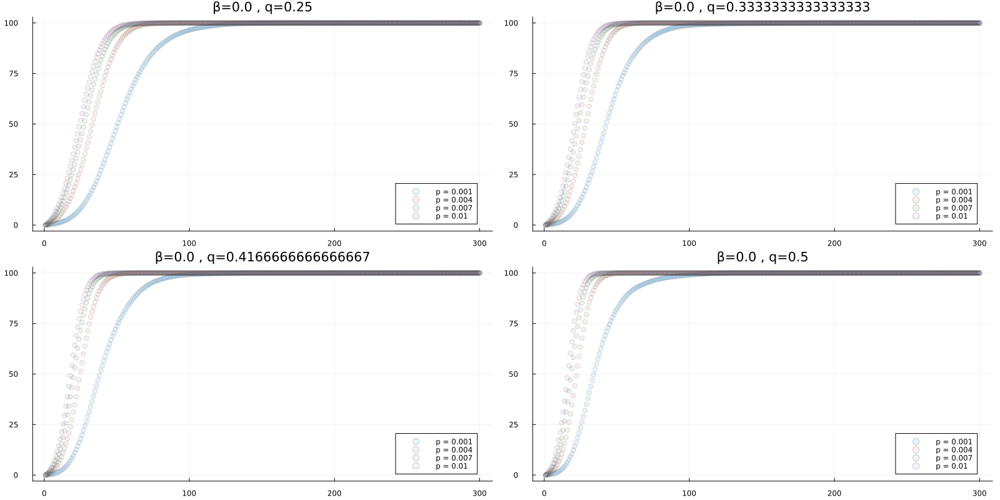

In [6]:
plots = [ plot() for q_ in q ] 
β_ = β[1]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800) )

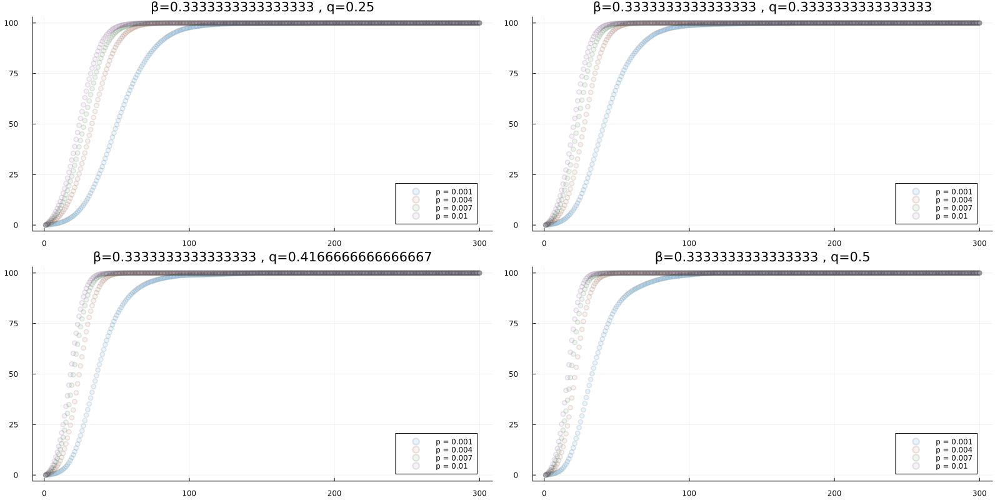

In [7]:
plots = [ plot() for q_ in q ] 
β_ = β[2]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800))

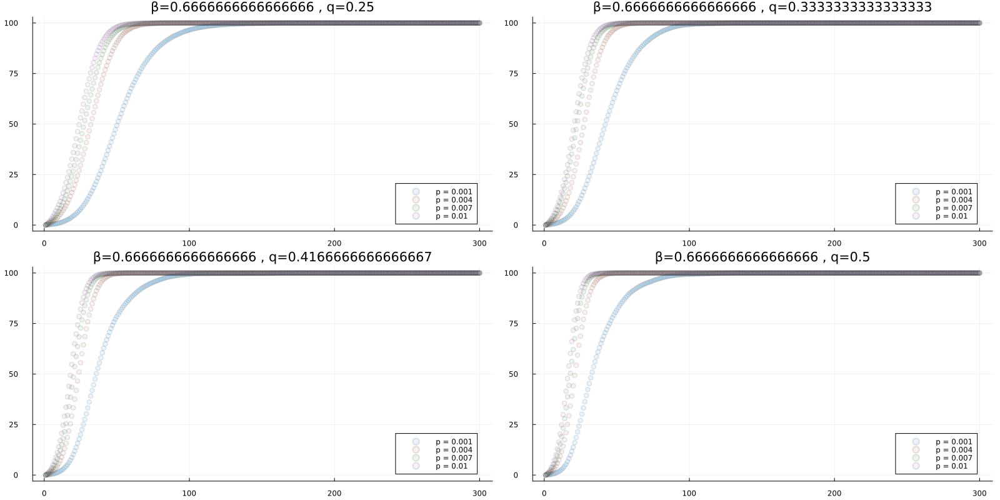

In [8]:
plots = [ plot() for q_ in q ] 
β_ = β[3]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800))

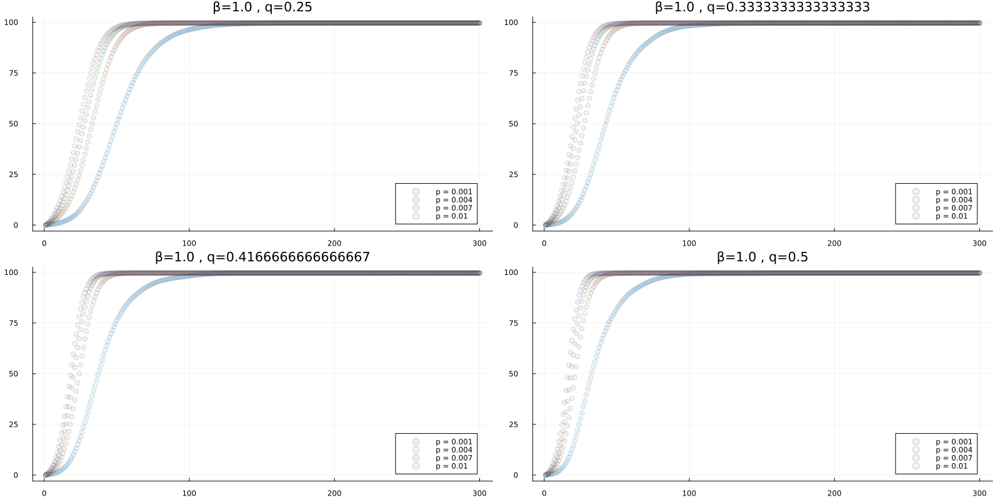

In [9]:
plots = [ plot() for q_ in q ] 
β_ = β[4]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800))

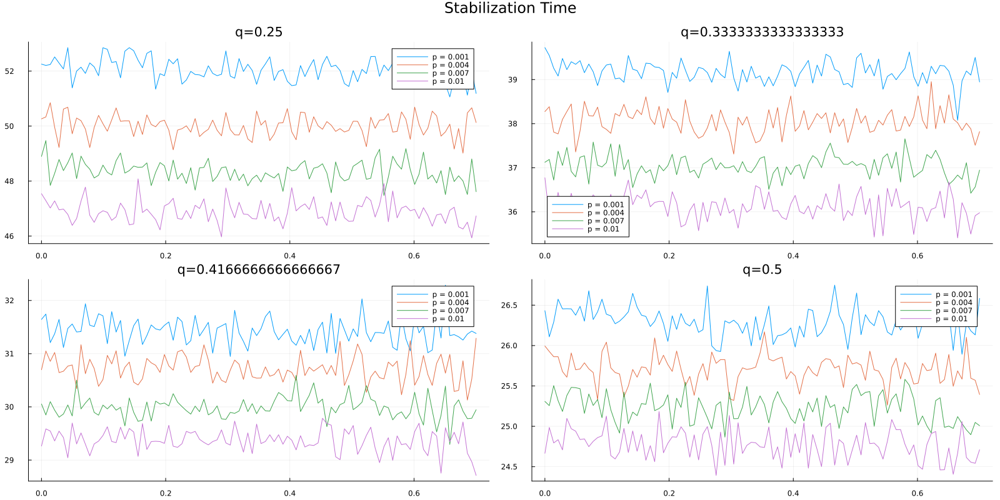

In [20]:
plots = [ plot() for q_ in q ] 
β = range(0,.7,100)
nit = 500

for i in eachindex( q ) 
    plots[i] = plot()
    for j in eachindex( p )
        time = Time_Stabilization.(nit , Ref(states0) , N , k ,β, p[j] , q[i] )  
        plots[i] = plot!( β,time , label =  "p = $(p[j])")
        title!("q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800) , suptitle = "Stabilization Time")

## Case II

In [11]:
nit = 300
states0 = zeros( Int, N )
states0[rand(1:N,8)] .= 1;

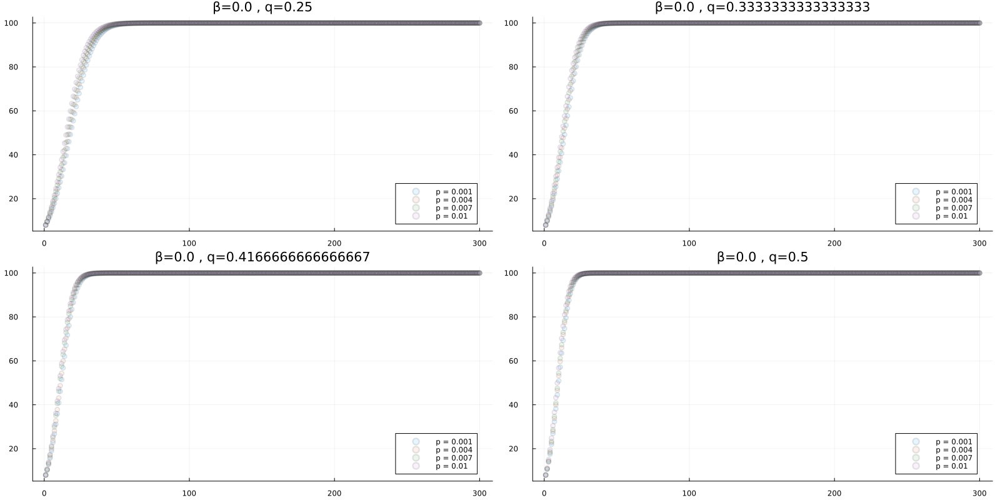

In [12]:
plots = [ plot() for q_ in q ] 
β_ = β[1]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800))


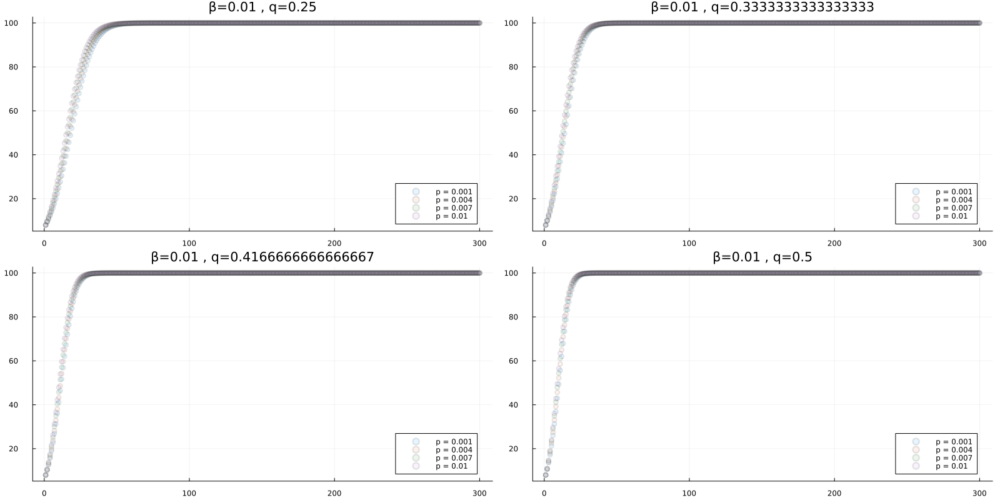

In [13]:
plots = [ plot() for q_ in q ] 
β_ = β[2]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800))


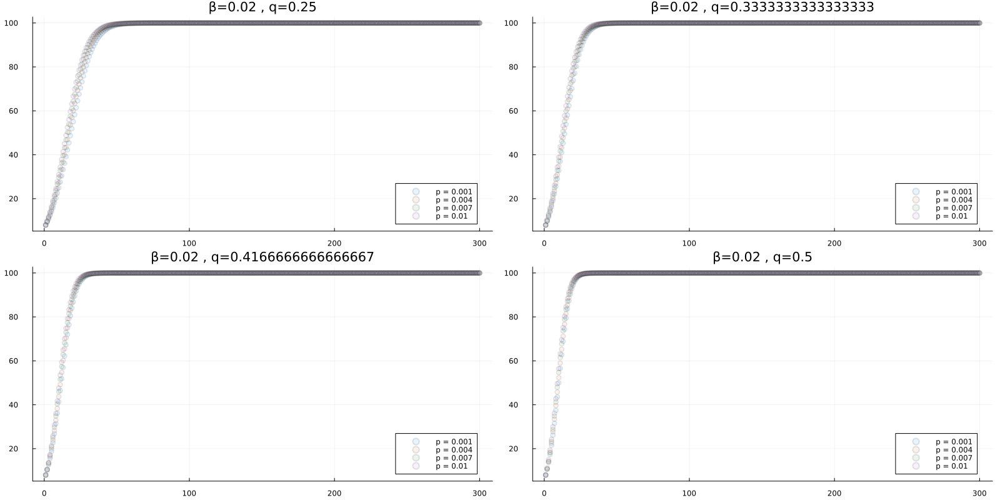

In [14]:
plots = [ plot() for q_ in q ] 
β_ = β[3]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800))


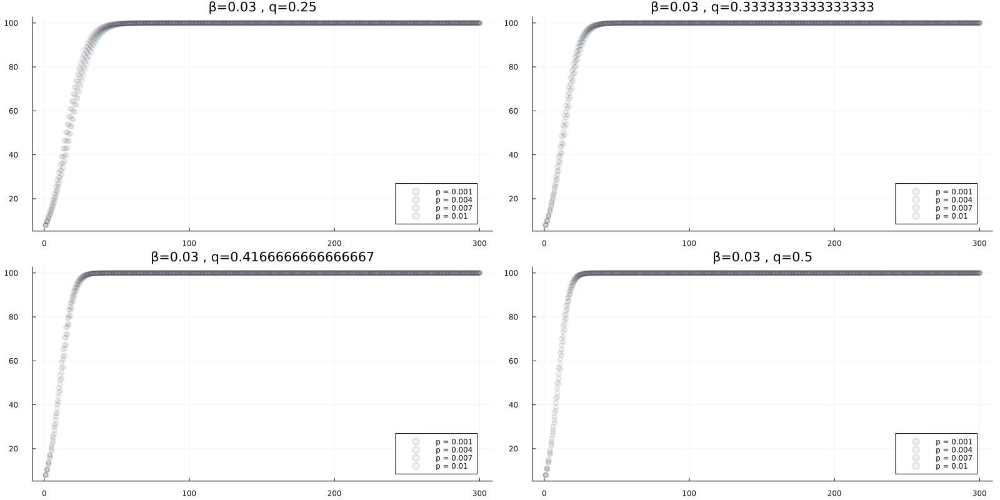

In [15]:
plots = [ plot() for q_ in q ] 
β_ = β[4]

for i in eachindex( plots ) 
    plots[i] = plot()
    for j in eachindex( p )
        plots[i] = scatter!( Adoption_State(nit , states0 , N , k ,β_, p[j] , q[i]) , label =  "p = $(p[j])" , alpha = .1)
        title!("β=$(β_) , q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800))


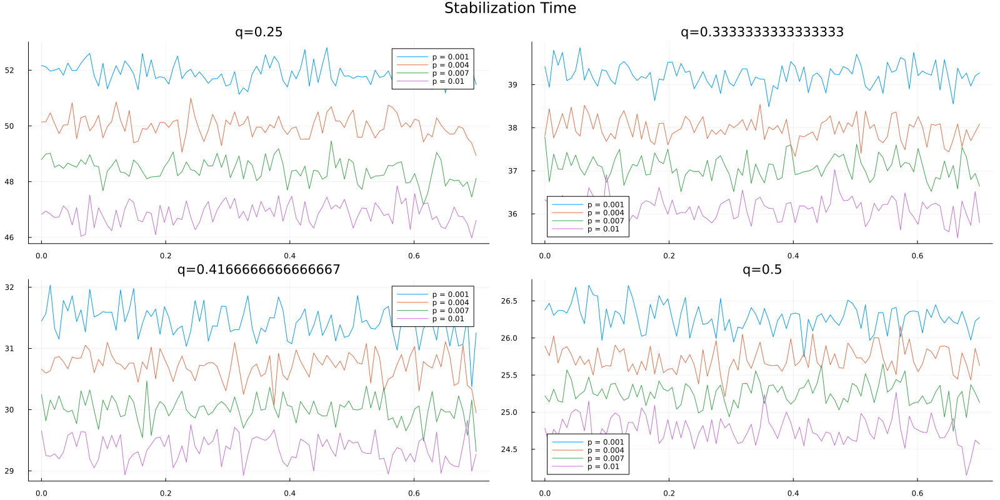

In [21]:
plots = [ plot() for q_ in q ] 
β = range(0,.7,100)
nit = 500

for i in eachindex( q ) 
    plots[i] = plot()
    for j in eachindex( p )
        time = Time_Stabilization.(nit , Ref(states0) , N , k ,β, p[j] , q[i] ) 
        plots[i] = plot!( β,time , label =  "p = $(p[j])")
        title!("q=$(q[i])")
    end
end
plot( plots... , layout = (2,2) , size = (1600,800) , suptitle = "Stabilization Time")

* # Part 3

In [38]:
function ODE!(du, u, P, t)
    F = u[1]
    p, q = P 
    du[1] = (1 - F) * (p + q * F)
end

function solve_model( p::Float64 , q::Float64 )
    tspan = (0.0,40.0)
    u0 = [0.0]
    ode = ODEProblem(ODE!, u0, tspan, [p,q])
    sol = solve(ode,RK4(),saveat=1.0)

    t = [ solution[1] for solution in sol.t ]
    y = [ solution[1] for solution in sol.u ];
    return t , y
end


solve_model (generic function with 1 method)

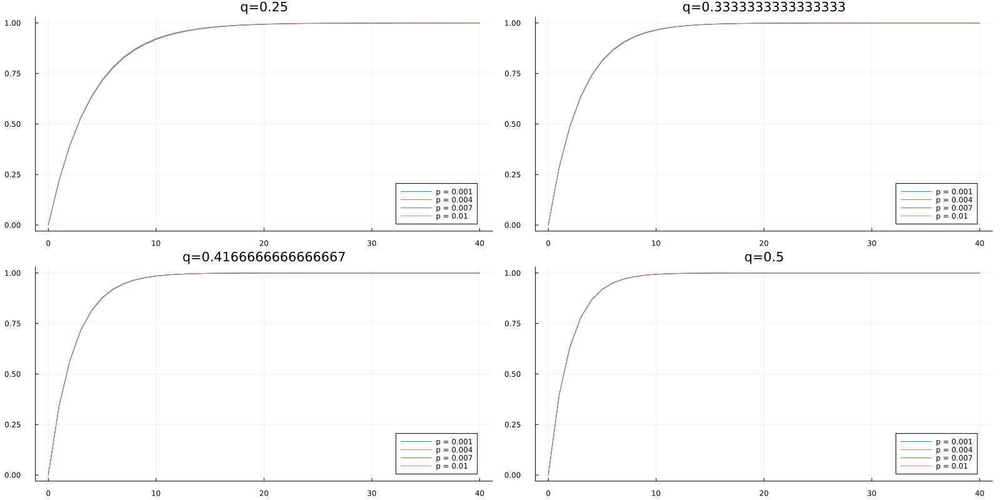

In [41]:
plots = [ plot() for q_ in q ] 

for i in eachindex( q ) 
    plots[i] = plot()
    for j in eachindex( p )
        t , y = solve_model( q[i] , p[j] )
        plots[i] = plot!( t , y , label =  "p = $(p[j])")
        title!("q=$(q[i])")
    end
end
plot( plots...  , size = (1600,800) )